## Bibliotecas

In [1]:
import pandas as pd
import numpy as np
import csv
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pathlib import Path
from typing import Optional, Tuple, List

## Funciones

In [2]:
seed = 666
np.random.seed(seed)

In [3]:
def find_first(path_glob_list: List[Path]) -> Optional[str]:
    """Devuelve la primera ruta que exista de una lista de patrones."""
    for p in path_glob_list:
        hits = list(p.parent.glob(p.name))
        if hits:
            return str(hits[0])
    return None

In [4]:
def attach_image_paths(
    dish_df: pd.DataFrame,
    images_root: str,
    rgb_name: str = "rgb",
    depth_name: str = "depth_raw",
) -> pd.DataFrame:
    """
    Agrega columnas 'rgb_path' y 'depth_path' a dish_df buscando en:
      <images_root>/<dish_id>/(rgb|depth_raw).(png|jpg)
    """
    root = Path(images_root)
    rgb_paths, depth_paths = [], []

    for did in dish_df["dish_id"]:
        ddir = root / did  # p.ej. .../realsense_overhead/dish_1561662216

        # patrones flexibles por si cambia extensión
        rgb_path = find_first([ddir / f"{rgb_name}.png", ddir / f"{rgb_name}.jpg"])
        depth_path = find_first([ddir / f"{depth_name}.png", ddir / f"{depth_name}.jpg"])

        rgb_paths.append(rgb_path)
        depth_paths.append(depth_path)

    out = dish_df.copy()
    out["rgb_path"] = rgb_paths
    out["depth_path"] = depth_paths
    out["has_rgb"] = out["rgb_path"].notna()
    out["has_depth"] = out["depth_path"].notna()
    return out

In [5]:
def parse_dish_metadata(paths):
    """
    paths: lista de rutas a CSVs como:
        ["nutrition5k_dataset/metadata/dish_metadata_cafe1.csv",
         "nutrition5k_dataset/metadata/dish_metadata_cafe2.csv"]
    Devuelve:
        dish_df: 1 fila por plato
        ingredients_df: 1 fila por ingrediente
    """
    dish_rows = []
    ingr_rows = []

    def is_int_like(x):
        try:
            int(x)
            return True
        except:
            return False

    for p in paths:
        with open(p, "r", encoding="utf-8") as f:
            reader = csv.reader(f, delimiter=",", skipinitialspace=True)
            for row in reader:
                if not row:
                    continue

                # --- Campos fijos de plato ---
                if len(row) < 6:
                    continue  # línea inválida
                dish_id = row[0]
                try:
                    total_calories = float(row[1]); total_mass = float(row[2])
                    total_fat = float(row[3]); total_carb = float(row[4]); total_protein = float(row[5])
                except ValueError:
                    # Si la línea trae valores corruptos, la omitimos
                    continue

                # --- Detectar num_ingrs y punto de inicio de ingredientes ---
                start_idx = 6
                num_ingrs = None
                if len(row) > 6 and is_int_like(row[6]):
                    num_ingrs = int(row[6])
                    start_idx = 7

                rem = row[start_idx:]

                # Algunos archivos podrían no incluir num_ingrs: intentamos inferir.
                # Los ingredientes vienen en bloques de 7 u 8 columnas.
                def choose_block_size(rem, num_ingrs):
                    # Si se conoce num_ingrs, priorizamos el tamaño que encaje exactamente
                    for b in (7, 8):
                        if num_ingrs is not None and len(rem) == b * num_ingrs:
                            return b
                    # Si no encaja exacto, probamos sin num_ingrs conocido
                    if num_ingrs is None:
                        if len(rem) % 7 == 0:
                            return 7
                        if len(rem) % 8 == 0:
                            return 8
                    # Último recurso: el que menos residuo deja
                    residues = {7: len(rem) % 7, 8: len(rem) % 8}
                    return min(residues, key=residues.get)

                block_size = choose_block_size(rem, num_ingrs)

                # Si num_ingrs venía y no cuadra, lo recalculamos
                if num_ingrs is None:
                    num_ingrs = len(rem) // block_size

                # Guardar nivel plato
                dish_rows.append({
                    "dish_id": dish_id,
                    "total_calories": total_calories,
                    "total_mass": total_mass,
                    "total_fat": total_fat,
                    "total_carb": total_carb,
                    "total_protein": total_protein,
                    "num_ingrs": num_ingrs
                })

                # Parsear bloques de ingredientes
                for k in range(num_ingrs):
                    s = k * block_size
                    e = s + block_size
                    if e > len(rem):
                        break  # evita desbordes si la fila está incompleta
                    seg = rem[s:e]

                    # Mapeo mínimo de 7 campos; si hay 8º, lo guardamos como 'extra'
                    ingr_id = seg[0] if len(seg) > 0 else None
                    ingr_name = seg[1] if len(seg) > 1 else None

                    def ffloat(x):
                        try:
                            return float(x)
                        except:
                            return None

                    ingr_grams   = ffloat(seg[2]) if len(seg) > 2 else None
                    ingr_cal     = ffloat(seg[3]) if len(seg) > 3 else None
                    ingr_fat     = ffloat(seg[4]) if len(seg) > 4 else None
                    ingr_carb    = ffloat(seg[5]) if len(seg) > 5 else None
                    ingr_protein = ffloat(seg[6]) if len(seg) > 6 else None
                    extra_field  = seg[7] if len(seg) > 7 else None  # por si existe un 8º campo

                    ingr_rows.append({
                        "dish_id": dish_id,
                        "ingr_id": ingr_id,
                        "ingr_name": ingr_name,
                        "ingr_grams": ingr_grams,
                        "ingr_calories": ingr_cal,
                        "ingr_fat": ingr_fat,
                        "ingr_carb": ingr_carb,
                        "ingr_protein": ingr_protein,
                        "extra": extra_field
                    })

    dish_df = pd.DataFrame(dish_rows).drop_duplicates(subset=["dish_id"])
    ingredients_df = pd.DataFrame(ingr_rows)

    return dish_df, ingredients_df


In [6]:
def show_samples(variable, percentile):
    percentile_99 = df_dishes[variable].quantile(percentile)
    df_dishes_99 = df_dishes[df_dishes[variable]>percentile_99]
    sample = df_dishes_99.sample(5,random_state=seed)
    plt.figure(figsize=(15,12))
    for i, (idx, row) in enumerate(sample.iterrows()):
        img = mpimg.imread(row['rgb_path'])
        plt.subplot(1, 5, i+1)
        plt.imshow(img)
        plt.title(f"ID: {row['dish_id']}")
        plt.axis("off")
    plt.show()    

## Lectura de Datos

In [7]:
dish_df, ingredients_df = parse_dish_metadata([
    "nutrition5k_dataset/metadata/dish_metadata_cafe1.csv",
    "nutrition5k_dataset/metadata/dish_metadata_cafe2.csv",
])

In [8]:
images_root = 'data/'

In [9]:
dish__df_with_paths = attach_image_paths(dish_df, images_root)

In [10]:
dish__df_with_paths

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
0,dish_1561662216,300.794281,193.0,12.387489,28.218290,18.633970,17,data/dish_1561662216/rgb.png,data/dish_1561662216/depth_raw.png,True,True
1,dish_1562688426,137.569992,88.0,8.256000,5.190000,10.297000,2,None,None,False,False
2,dish_1561662054,419.438782,292.0,23.838249,26.351543,25.910593,17,data/dish_1561662054/rgb.png,data/dish_1561662054/depth_raw.png,True,True
3,dish_1562008979,382.936646,290.0,22.224644,10.173570,35.345387,13,data/dish_1562008979/rgb.png,data/dish_1562008979/depth_raw.png,True,True
4,dish_1560455030,20.590000,103.0,0.148000,4.625000,0.956000,3,data/dish_1560455030/rgb.png,data/dish_1560455030/depth_raw.png,True,True
...,...,...,...,...,...,...,...,...,...,...,...
5001,dish_1571934465,0.000000,232.0,0.000000,0.000000,0.000000,1,data/dish_1571934465/rgb.png,data/dish_1571934465/depth_raw.png,True,True
5002,dish_1573073666,0.000000,15.0,0.000000,0.000000,0.000000,5,data/dish_1573073666/rgb.png,data/dish_1573073666/depth_raw.png,True,True
5003,dish_1575924356,0.000000,103.0,0.000000,0.000000,0.000000,1,None,None,False,False
5004,dish_1574359199,0.000000,329.0,0.000000,0.000000,0.000000,3,data/dish_1574359199/rgb.png,data/dish_1574359199/depth_raw.png,True,True


## Exploracion de Datos

In [11]:
dish__df_with_paths.isnull().sum()

dish_id              0
total_calories       0
total_mass           0
total_fat            0
total_carb           0
total_protein        0
num_ingrs            0
rgb_path          1516
depth_path        1516
has_rgb              0
has_depth            0
dtype: int64

In [12]:
ingredients_df.isnull().sum()

dish_id              0
ingr_id              0
ingr_name            0
ingr_grams           0
ingr_calories        0
ingr_fat             0
ingr_carb            0
ingr_protein         0
extra            28455
dtype: int64

In [13]:
ingredients_df

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
0,dish_1561662216,ingr_0000000508,soy sauce,3.398568,1.801241,0.020391,0.166530,0.275284,None
1,dish_1561662216,ingr_0000000122,garlic,2.124105,3.164916,0.010621,0.700955,0.135943,None
2,dish_1561662216,ingr_0000000026,white rice,8.496420,11.045346,0.025489,2.378998,0.229403,None
3,dish_1561662216,ingr_0000000524,parsley,0.213397,0.079170,0.001707,0.013657,0.006189,None
4,dish_1561662216,ingr_0000000094,onions,1.707173,0.682869,0.001707,0.153646,0.018779,None
...,...,...,...,...,...,...,...,...,...
28450,dish_1576171157,ingr_0000000077,almonds,0.294420,1.702042,0.145738,0.066833,0.065950,None
28451,dish_1576171157,ingr_0000000161,olive oil,1.430858,12.648785,1.430858,0.000000,0.000000,None
28452,dish_1576171157,ingr_0000000203,chili,0.953905,0.381562,0.003816,0.084898,0.017170,None
28453,dish_1576171157,ingr_0000000291,salt,0.008412,0.000000,0.000000,0.000000,0.000000,None


* Podemos ver que hay platos que solo tienen el total de masa y no los macronutrientes que necesitamos
* Otros PLatos por otro lado no tienen las imagenes

In [14]:
dish__df_with_paths[dish__df_with_paths['total_calories'] == 0].sample(10)

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
4831,dish_1572376802,0.0,150.0,0.0,0.0,0.0,3,None,None,False,False
4931,dish_1571931809,0.0,139.0,0.0,0.0,0.0,3,None,None,False,False
4990,dish_1573156961,0.0,318.0,0.0,0.0,0.0,10,data/dish_1573156961/rgb.png,data/dish_1573156961/depth_raw.png,True,True
4954,dish_1572540934,0.0,357.0,0.0,0.0,0.0,3,data/dish_1572540934/rgb.png,data/dish_1572540934/depth_raw.png,True,True
4902,dish_1573072447,0.0,196.0,0.0,0.0,0.0,7,data/dish_1573072447/rgb.png,data/dish_1573072447/depth_raw.png,True,True
4773,dish_1572984706,0.0,118.0,0.0,0.0,0.0,5,data/dish_1572984706/rgb.png,data/dish_1572984706/depth_raw.png,True,True
4819,dish_1572548822,0.0,77.0,0.0,0.0,0.0,9,data/dish_1572548822/rgb.png,data/dish_1572548822/depth_raw.png,True,True
4953,dish_1572625763,0.0,156.0,0.0,0.0,0.0,2,data/dish_1572625763/rgb.png,data/dish_1572625763/depth_raw.png,True,True
4936,dish_1572988785,0.0,107.0,0.0,0.0,0.0,6,data/dish_1572988785/rgb.png,data/dish_1572988785/depth_raw.png,True,True
4880,dish_1573579406,0.0,110.0,0.0,0.0,0.0,2,data/dish_1573579406/rgb.png,data/dish_1573579406/depth_raw.png,True,True


In [15]:
dish__df_with_paths[dish__df_with_paths['has_rgb'] == False]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
1,dish_1562688426,137.569992,88.0,8.256000,5.19,10.297000,2,None,None,False,False
6,dish_1563379132,232.050003,119.0,14.280000,14.28,10.591001,1,None,None,False,False
10,dish_1550795690,68.119995,131.0,0.262000,18.34,0.393000,1,None,None,False,False
14,dish_1550876012,253.520004,207.0,4.455999,12.46,38.608002,3,None,None,False,False
15,dish_1551565034,7.790000,19.0,0.038000,1.90,0.171000,1,None,None,False,False
...,...,...,...,...,...,...,...,...,...,...,...
4931,dish_1571931809,0.000000,139.0,0.000000,0.00,0.000000,3,None,None,False,False
4946,dish_1571931623,0.000000,151.0,0.000000,0.00,0.000000,2,None,None,False,False
4956,dish_1572032356,0.000000,262.0,0.000000,0.00,0.000000,17,None,None,False,False
4959,dish_1573679123,0.000000,152.0,0.000000,0.00,0.000000,12,None,None,False,False


In [16]:
dish__df_with_paths[dish__df_with_paths['has_depth'] == False]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
1,dish_1562688426,137.569992,88.0,8.256000,5.19,10.297000,2,None,None,False,False
6,dish_1563379132,232.050003,119.0,14.280000,14.28,10.591001,1,None,None,False,False
10,dish_1550795690,68.119995,131.0,0.262000,18.34,0.393000,1,None,None,False,False
14,dish_1550876012,253.520004,207.0,4.455999,12.46,38.608002,3,None,None,False,False
15,dish_1551565034,7.790000,19.0,0.038000,1.90,0.171000,1,None,None,False,False
...,...,...,...,...,...,...,...,...,...,...,...
4931,dish_1571931809,0.000000,139.0,0.000000,0.00,0.000000,3,None,None,False,False
4946,dish_1571931623,0.000000,151.0,0.000000,0.00,0.000000,2,None,None,False,False
4956,dish_1572032356,0.000000,262.0,0.000000,0.00,0.000000,17,None,None,False,False
4959,dish_1573679123,0.000000,152.0,0.000000,0.00,0.000000,12,None,None,False,False


In [17]:
100*(len(dish__df_with_paths[dish__df_with_paths['total_calories'] == 0])/len(dish__df_with_paths))

4.794246903715541

In [18]:
100*(len(dish__df_with_paths[dish__df_with_paths['has_rgb'] == False])/len(dish__df_with_paths))

30.283659608469836

In [19]:
100*(len(dish__df_with_paths[dish__df_with_paths['has_depth'] == False])/len(dish__df_with_paths))

30.283659608469836

In [20]:
dish__df_with_paths[dish__df_with_paths['has_depth'] == True].sample(10)

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
4724,dish_1563391413,227.056778,237.0,14.303798,6.997268,26.228392,21,data/dish_1563391413/rgb.png,data/dish_1563391413/depth_raw.png,True,True
367,dish_1565811091,504.400024,371.0,17.632000,9.060000,74.731003,5,data/dish_1565811091/rgb.png,data/dish_1565811091/depth_raw.png,True,True
1162,dish_1561579673,221.304153,360.0,7.604510,22.447077,18.344212,20,data/dish_1561579673/rgb.png,data/dish_1561579673/depth_raw.png,True,True
287,dish_1558461431,1.150000,5.0,0.020000,0.180000,0.145000,1,data/dish_1558461431/rgb.png,data/dish_1558461431/depth_raw.png,True,True
618,dish_1566333194,461.585266,220.0,18.614201,36.067131,35.169743,17,data/dish_1566333194/rgb.png,data/dish_1566333194/depth_raw.png,True,True
3777,dish_1564169644,433.416992,163.0,15.322000,54.605000,18.256001,1,data/dish_1564169644/rgb.png,data/dish_1564169644/depth_raw.png,True,True
1154,dish_1558725226,19.750000,79.0,0.237000,3.950000,1.422000,1,data/dish_1558725226/rgb.png,data/dish_1558725226/depth_raw.png,True,True
2927,dish_1558724766,83.719994,161.0,0.322000,22.540001,0.483000,1,data/dish_1558724766/rgb.png,data/dish_1558724766/depth_raw.png,True,True
4571,dish_1564690138,190.499496,181.0,6.844433,24.872919,10.031026,11,data/dish_1564690138/rgb.png,data/dish_1564690138/depth_raw.png,True,True
2405,dish_1558723742,375.109985,264.0,22.268999,40.230000,13.325000,4,data/dish_1558723742/rgb.png,data/dish_1558723742/depth_raw.png,True,True


* A pesar de el alto porcentaje de elementos faltanrtes (30%) vamos a optar por quitar estos eleemtnos ya que las imagenes son parte fundamental del proyecto

In [21]:
df_dishes = dish__df_with_paths[dish__df_with_paths['has_depth'] == True].copy()

* Podemos ver que son los mismos los casos donde no hay fotos rgb y deepth

In [22]:
df_dishes[df_dishes['has_rgb'] == False]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth


* Con el 'describe' podemos ver que hay varios outliers que hacen muy pesada la cola a la derecha de la distribucion

In [23]:
df_dishes.describe([0.1,0.25,0.5,0.75,0.9,0.98,0.99]).T

,count,mean,std,min,10%,25%,50%,75%,90%,98%,99%,max
total_calories,3490.0,238.352880,221.495560,0.0,15.6360,61.002499,189.061005,362.164925,525.424121,792.188439,908.717686,3943.325195
total_mass,3490.0,211.415759,158.635065,1.0,52.0000,92.000000,172.000000,300.000000,417.000000,599.220000,696.110000,3051.000000
total_fat,3490.0,11.896143,13.449972,0.0,0.1080,0.615416,7.733688,18.113808,29.811497,50.573004,58.904999,106.343002
total_carb,3490.0,18.119625,21.429815,0.0,1.0594,4.850000,13.935500,26.350872,41.574942,61.545587,67.960536,844.568604
total_protein,3490.0,16.828267,19.882833,0.0,0.4260,1.519000,9.867500,26.597500,43.002096,75.544769,83.848096,147.491821
num_ingrs,3490.0,7.171347,6.839174,1.0,1.0000,1.000000,4.000000,12.000000,18.000000,24.000000,26.000000,34.000000


In [24]:
lst_col_num = df_dishes.select_dtypes(include = ['float64','int64']).columns

In [25]:
lst_col_num

Index(['total_calories', 'total_mass', 'total_fat', 'total_carb',
       'total_protein', 'num_ingrs'],
      dtype='object')

In [26]:
for var in lst_col_num:
    fig = px.histogram(df_dishes, x = var, nbins=40, title = f'Histograma de {var}')
    fig.show()

### total_calories

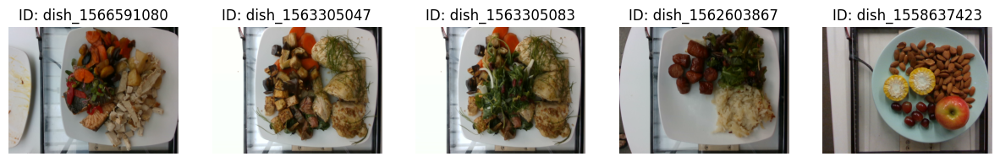

In [27]:
show_samples('total_calories',0.99)

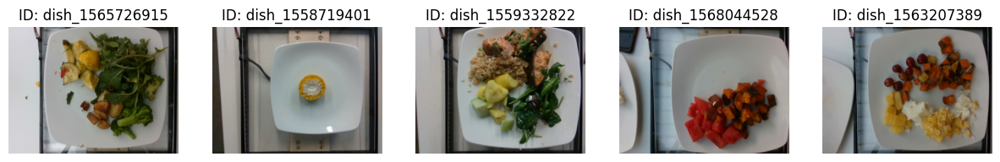

In [28]:
show_samples('total_calories',0)

### total_mass

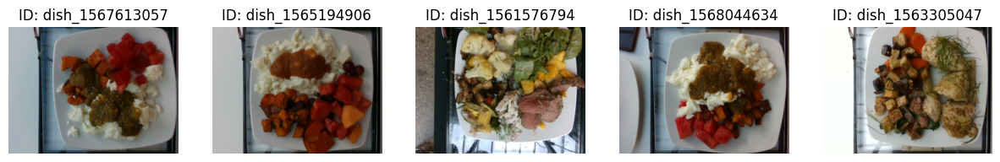

In [29]:
show_samples('total_mass',0.99)

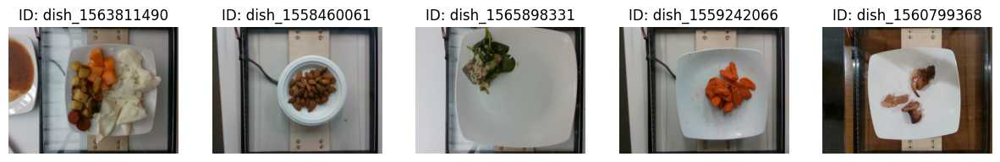

In [30]:
show_samples('total_mass',0)

### total_fat

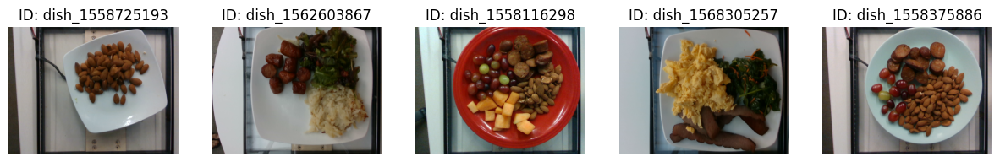

In [31]:
show_samples('total_fat',0.99)

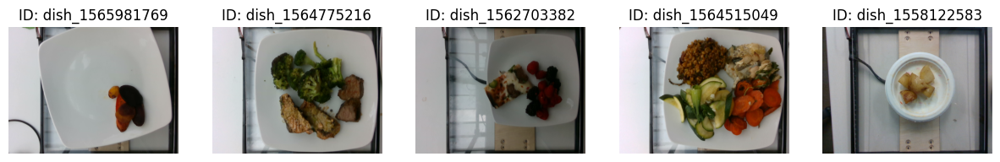

In [32]:
show_samples('total_fat',0)

### total_carb

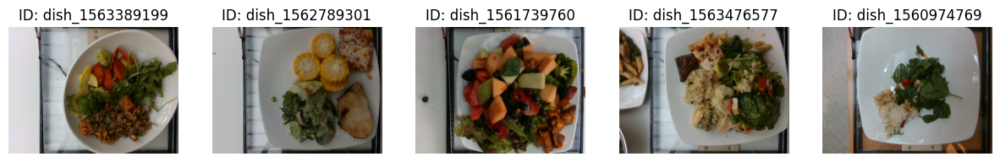

In [33]:
show_samples('total_carb',0.99)

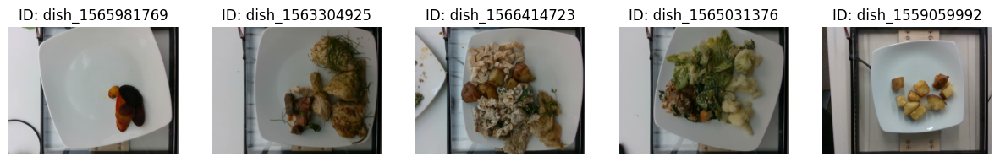

In [34]:
show_samples('total_carb',0)

### total_protein

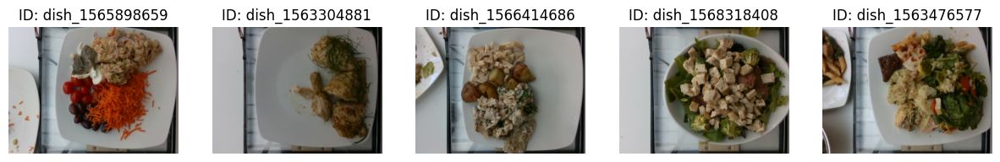

In [35]:
show_samples('total_protein',0.99)

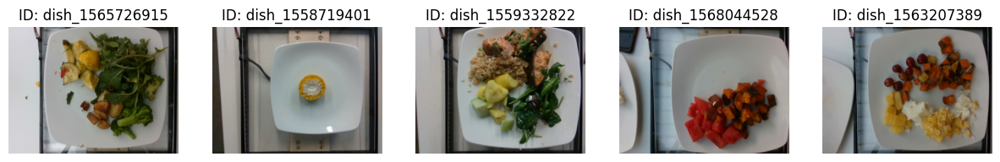

In [36]:
show_samples('total_protein',0)

* Al analizar samples de los outliers y compararlos considere dejar los outliers para no perder platos y aplicar una transformacion logaritmica

* Hay platillos que parecen no tener calorias ni macros, esto claramente es un error

In [37]:
df_dishes_zero_cal = df_dishes[df_dishes['total_calories'] == 0].copy()
df_dishes_zero_cal

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
376,dish_1557861216,0.0,1.0,0.0,0.0,0.0,1,data/dish_1557861216/rgb.png,data/dish_1557861216/depth_raw.png,True,True
3892,dish_1556575700,0.0,86.0,0.0,0.0,0.0,1,data/dish_1556575700/rgb.png,data/dish_1556575700/depth_raw.png,True,True
4768,dish_1572974428,0.0,74.0,0.0,0.0,0.0,8,data/dish_1572974428/rgb.png,data/dish_1572974428/depth_raw.png,True,True
4769,dish_1572464692,0.0,56.0,0.0,0.0,0.0,1,data/dish_1572464692/rgb.png,data/dish_1572464692/depth_raw.png,True,True
4770,dish_1571931594,0.0,66.0,0.0,0.0,0.0,1,data/dish_1571931594/rgb.png,data/dish_1571931594/depth_raw.png,True,True
...,...,...,...,...,...,...,...,...,...,...,...
5000,dish_1574455483,0.0,168.0,0.0,0.0,0.0,9,data/dish_1574455483/rgb.png,data/dish_1574455483/depth_raw.png,True,True
5001,dish_1571934465,0.0,232.0,0.0,0.0,0.0,1,data/dish_1571934465/rgb.png,data/dish_1571934465/depth_raw.png,True,True
5002,dish_1573073666,0.0,15.0,0.0,0.0,0.0,5,data/dish_1573073666/rgb.png,data/dish_1573073666/depth_raw.png,True,True
5004,dish_1574359199,0.0,329.0,0.0,0.0,0.0,3,data/dish_1574359199/rgb.png,data/dish_1574359199/depth_raw.png,True,True


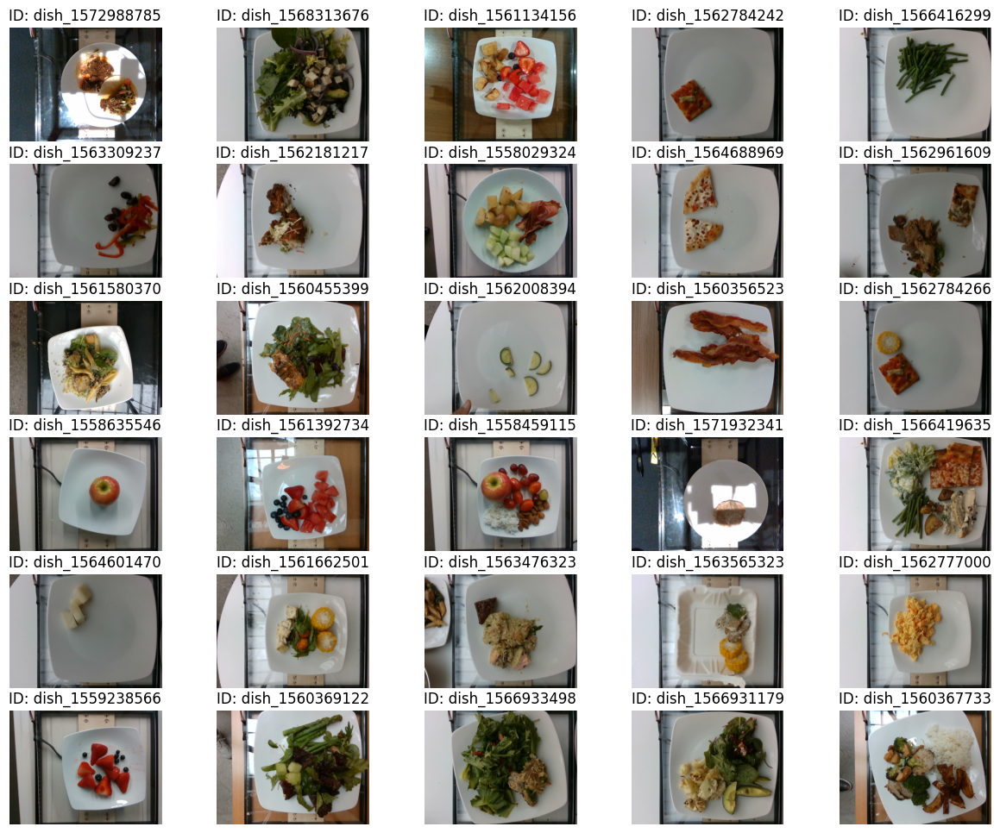

In [38]:
aux = df_dishes.sample(30,random_state=seed)
plt.figure(figsize=(15,12))
for i, (idx, row) in enumerate(aux.iterrows()):
    img = mpimg.imread(row['rgb_path'])
    plt.subplot(6, 5, i+1)
    plt.imshow(img)
    plt.title(f"ID: {row['dish_id']}")
    plt.axis("off")
plt.show()    

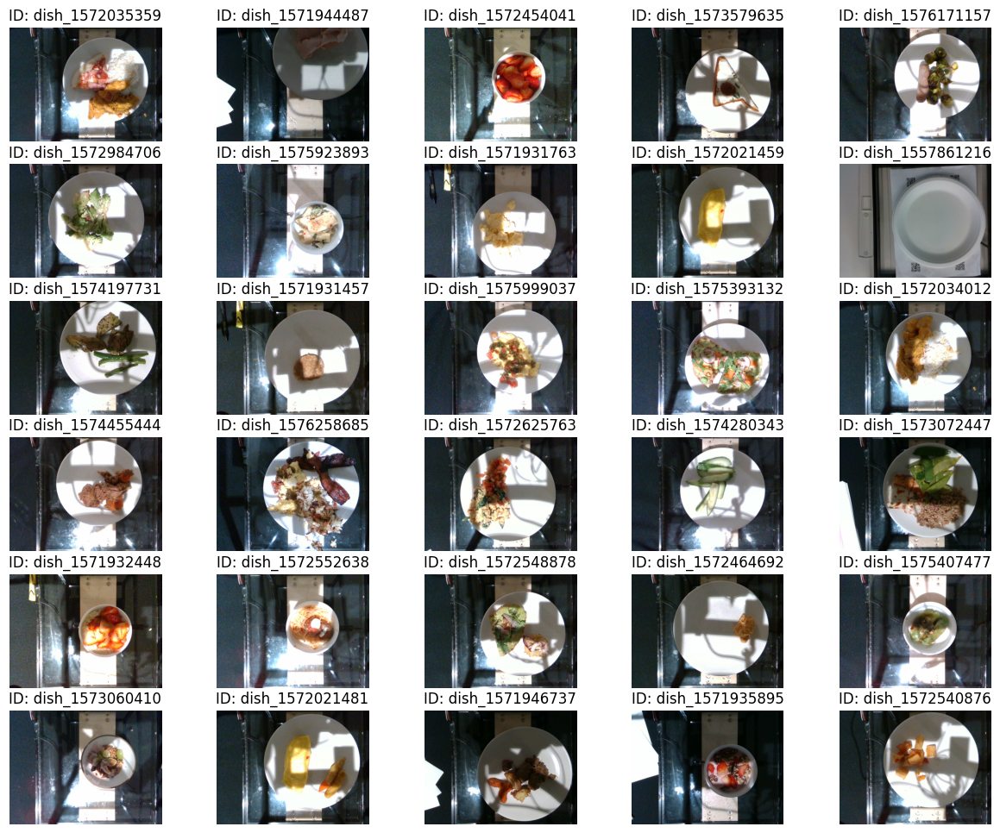

In [39]:
aux = df_dishes_zero_cal.sample(30,random_state=seed)
plt.figure(figsize=(15,12))
for i, (idx, row) in enumerate(aux.iterrows()):
    img = mpimg.imread(row['rgb_path'])
    plt.subplot(6, 5, i+1)
    plt.imshow(img)
    plt.title(f"ID: {row['dish_id']}")
    plt.axis("off")
plt.show()    

* Parece haber un patron de figuras con iluminacion mala en sus fotos

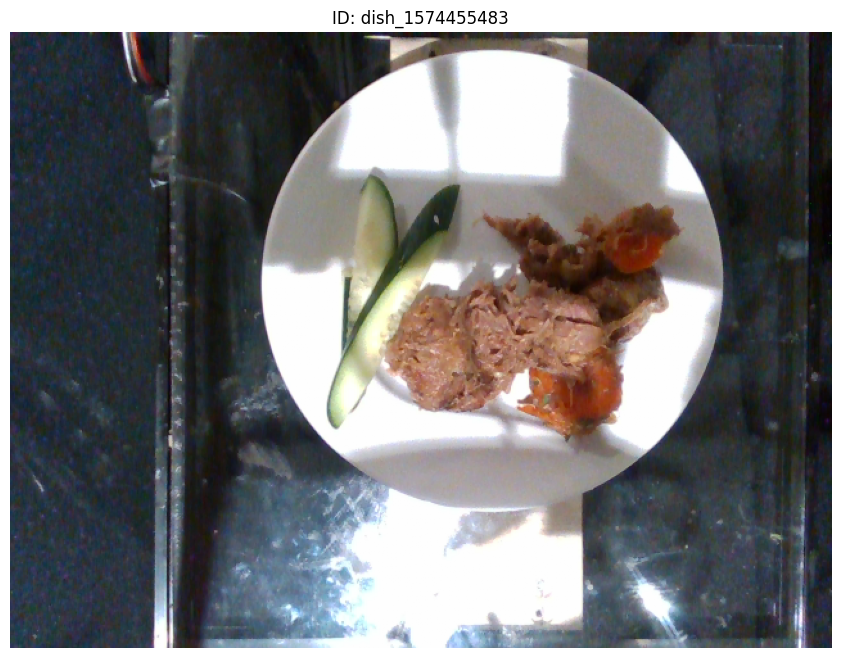

In [40]:
plt.figure(figsize=(15,8))
img = mpimg.imread(df_dishes_zero_cal[df_dishes_zero_cal['dish_id'] == 'dish_1574455483']['rgb_path'].iloc[0])
plt.imshow(img)
plt.title(f"ID: {df_dishes_zero_cal[df_dishes_zero_cal['dish_id'] == 'dish_1574455483']['dish_id'].iloc[0]}")
plt.axis("off")
plt.show()    

In [41]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1574455483']

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
28430,dish_1574455483,ingr_0000000031,cucumbers,21.000000,2.100000,0.000000,0.420000,0.210000,None
28431,dish_1574455483,ingr_0000000034,celery,2.275223,0.364036,0.004550,0.077358,0.015927,None
28432,dish_1574455483,ingr_0000000045,carrot,2.275223,0.932841,0.004550,0.227522,0.020477,None
28433,dish_1574455483,ingr_0000000094,onions,2.275223,0.910089,0.002275,0.204770,0.025027,None
28434,dish_1574455483,ingr_0000000159,apple cider,18.201782,8.409223,0.018202,2.056801,0.018202,None
28435,dish_1574455483,ingr_0000000189,vinegar,1.153254,0.000000,0.000000,0.000000,0.000000,None
28436,dish_1574455483,ingr_0000000252,broth,6.967870,18.395177,1.024277,1.289056,1.149699,None
28437,dish_1574455483,ingr_0000000291,salt,0.090288,0.000000,0.000000,0.000000,0.000000,None
28438,dish_1574455483,ingr_0000000462,pork,113.761139,270.751511,15.926559,0.000000,29.577896,None


In [42]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1574455483']['ingr_grams'].sum()

np.float64(168.000002)

In [43]:
df_dishes_zero_cal[df_dishes_zero_cal['dish_id'] == 'dish_1574455483']

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
5000,dish_1574455483,0.0,168.0,0.0,0.0,0.0,9,data/dish_1574455483/rgb.png,data/dish_1574455483/depth_raw.png,True,True


* Al analizar algunos platillos con la tabla de ingredientes se puede ver que si estan los registros aunque las fotos siguen siendo una opciona  tomar en cuenta

In [44]:
df_dishes_fil = df_dishes[df_dishes['total_calories'] >0].copy()

### Hipotesis

 * La cantidad de calorias esta dada por una a proximacion de:
*total_calories≈4×total_carb+4×total_protein+9×total_fat*
* La suma de los macronutrientes tiene que ser menor al total de masa del plato ya que hay agua, fibra y micronutrientes

In [45]:
array_cal = df_dishes_fil['total_calories'].to_numpy()
array_cal_form = (df_dishes_fil['total_fat']*9 + df_dishes_fil['total_protein']*4 + df_dishes_fil['total_carb']*4).to_numpy()

In [46]:
error = np.abs(array_cal_form - array_cal)/array_cal *100
print(f'Errores porcentuales promedio: {error.mean()}')

Errores porcentuales promedio: 7.637168500090347


* Podemos ver que la hipotesis se cumple para los ejemplos seleccionados y las calorias vienen dadas por la formula: *total_calories≈4×total_carb+4×total_protein+9×total_fat*

In [47]:
df_dishes_fil[df_dishes_fil['total_mass'] < (df_dishes_fil['total_fat']  + df_dishes_fil['total_protein'] + df_dishes_fil['total_carb'] )]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth


* Podemos ver que se cumple la hipotesis y no hay errores de anotacion de macronutrientes que superen la masa

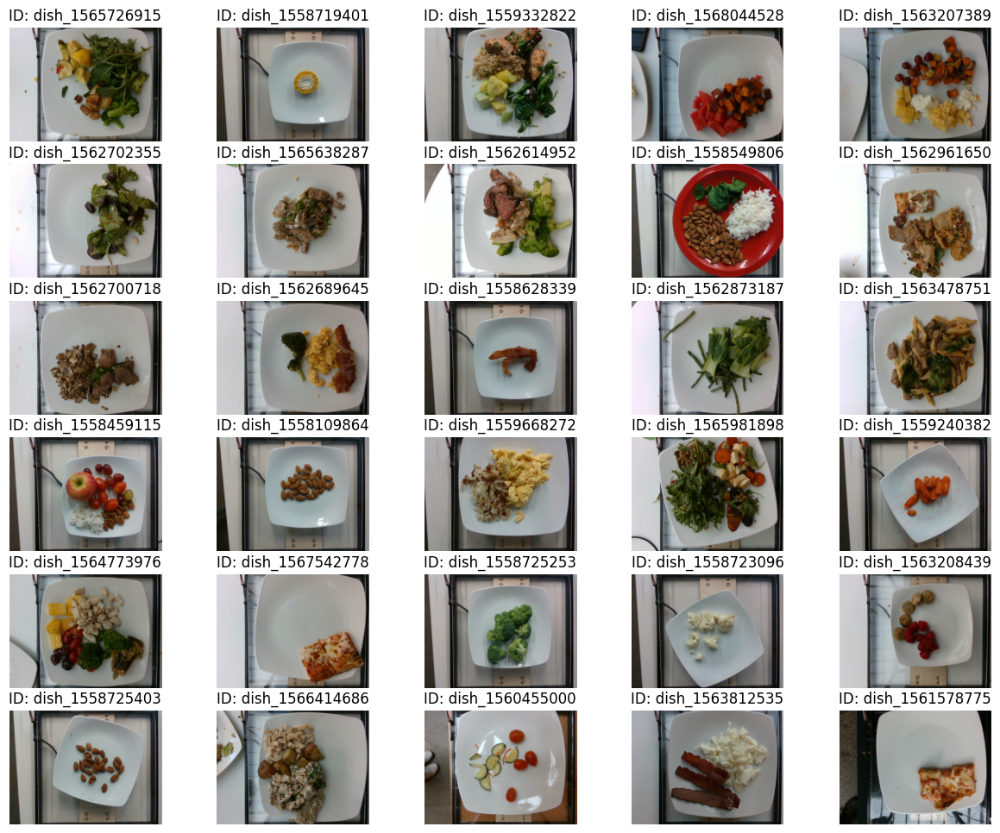

In [48]:
aux = df_dishes_fil.sample(30,random_state=seed)
plt.figure(figsize=(15,12))
for i, (idx, row) in enumerate(aux.iterrows()):
    img = mpimg.imread(row['rgb_path'])
    plt.subplot(6, 5, i+1)
    plt.imshow(img)
    plt.title(f"ID: {row['dish_id']}")
    plt.axis("off")
plt.show()    

In [49]:
df_dishes_fil

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth
0,dish_1561662216,300.794281,193.0,12.387489,28.218290,18.633970,17,data/dish_1561662216/rgb.png,data/dish_1561662216/depth_raw.png,True,True
2,dish_1561662054,419.438782,292.0,23.838249,26.351543,25.910593,17,data/dish_1561662054/rgb.png,data/dish_1561662054/depth_raw.png,True,True
3,dish_1562008979,382.936646,290.0,22.224644,10.173570,35.345387,13,data/dish_1562008979/rgb.png,data/dish_1562008979/depth_raw.png,True,True
4,dish_1560455030,20.590000,103.0,0.148000,4.625000,0.956000,3,data/dish_1560455030/rgb.png,data/dish_1560455030/depth_raw.png,True,True
5,dish_1558372433,74.360001,143.0,0.286000,0.429000,20.020000,1,data/dish_1558372433/rgb.png,data/dish_1558372433/depth_raw.png,True,True
...,...,...,...,...,...,...,...,...,...,...,...
4760,dish_1563295334,228.540009,96.0,17.380001,1.492000,15.540001,2,data/dish_1563295334/rgb.png,data/dish_1563295334/depth_raw.png,True,True
4762,dish_1566329234,262.625214,457.0,10.797179,21.224293,23.129114,10,data/dish_1566329234/rgb.png,data/dish_1566329234/depth_raw.png,True,True
4765,dish_1562691737,485.676880,700.0,11.722251,70.597321,27.926394,11,data/dish_1562691737/rgb.png,data/dish_1562691737/depth_raw.png,True,True
4766,dish_1558458496,53.130001,77.0,0.154000,13.860001,0.539000,1,data/dish_1558458496/rgb.png,data/dish_1558458496/depth_raw.png,True,True


In [50]:
dishes_id = df_dishes_fil['dish_id'].tolist()

* Grabamos los dishes_id para obtener los videos y frames de diferentes angulos de los platos

In [51]:
with open('dishes_fil.txt', 'w') as f:
    for nombre in dishes_id:
        f.write(f'{nombre}\n')

In [52]:
path_videos = Path('/home/paul-h-roldan-hernandez/Documentos/Diplomado/Modulo_5/Proyecto/Videos')
nombres_videos = {'camera_A.h264', 'camera_B.h264', 'camera_C.h264', 'camera_D.h264'}

In [53]:
num_videos_list = []
has_all_4_list = []
present_list = []
missing_list = []
folder_exists_list = []

for _, r in df_dishes_fil.iterrows():
    dish = r['dish_id']
    folder = path_videos / dish

    if folder.is_dir():
        files = {f.name for f in folder.iterdir() if f.is_file()}
        present = sorted(nombres_videos & files)
        missing = sorted(nombres_videos - files)
        folder_exists = True
    else:
        # Carpeta no existe: todo falta
        present = []
        missing = sorted(nombres_videos)
        folder_exists = False

    num_videos_list.append(len(present))
    has_all_4_list.append(len(present) == 4)
    present_list.append(present)
    missing_list.append(missing)
    folder_exists_list.append(folder_exists)

df_dishes_fil['video_folder_exists'] = folder_exists_list
df_dishes_fil['video_files_present'] = present_list
df_dishes_fil['missing_videos'] = missing_list
df_dishes_fil['num_videos'] = num_videos_list
df_dishes_fil['has_all_4'] = has_all_4_list

* Registros con videos no disponibles

In [54]:
df_dishes_fil[df_dishes_fil['video_folder_exists'] ==False ]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth,video_folder_exists,video_files_present,missing_videos,num_videos,has_all_4
30,dish_1564432238,455.387939,315.0,23.154680,34.854778,28.074873,22,data/dish_1564432238/rgb.png,data/dish_1564432238/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
49,dish_1564686855,1030.160645,435.0,52.116467,85.930336,56.845505,14,data/dish_1564686855/rgb.png,data/dish_1564686855/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
69,dish_1564761488,327.986023,336.0,8.358000,40.558998,21.735001,4,data/dish_1564761488/rgb.png,data/dish_1564761488/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
75,dish_1564428444,157.001038,277.0,10.327390,14.948835,4.712034,10,data/dish_1564428444/rgb.png,data/dish_1564428444/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
82,dish_1564777960,331.007507,147.0,16.715342,16.270294,26.431200,10,data/dish_1564777960/rgb.png,data/dish_1564777960/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4625,dish_1564675193,478.808777,803.0,5.210829,46.038174,54.254734,5,data/dish_1564675193/rgb.png,data/dish_1564675193/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
4705,dish_1564691450,542.326721,366.0,35.475227,28.016935,32.657883,17,data/dish_1564691450/rgb.png,data/dish_1564691450/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
4709,dish_1565021599,206.959991,398.0,0.796000,2.786000,39.799999,1,data/dish_1565021599/rgb.png,data/dish_1565021599/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
4734,dish_1564514906,199.266052,178.0,20.851080,8.858501,25.466618,14,data/dish_1564514906/rgb.png,data/dish_1564514906/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False


* Numero de Videos en los registros

<Axes: >

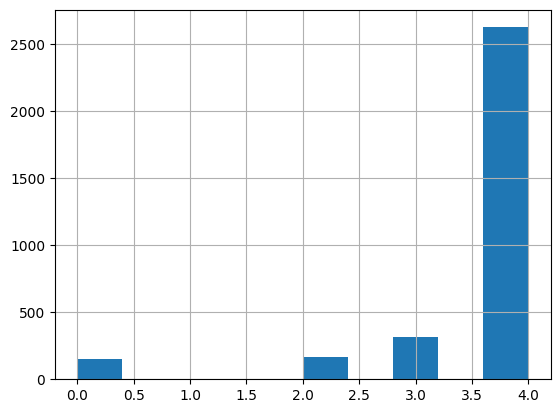

In [55]:
df_dishes_fil['num_videos'].hist()

In [56]:
df_dishes_fil[df_dishes_fil['has_all_4'] ==False ]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth,video_folder_exists,video_files_present,missing_videos,num_videos,has_all_4
13,dish_1568649312,44.459999,78.0,0.234000,10.920000,0.546000,1,data/dish_1568649312/rgb.png,data/dish_1568649312/depth_raw.png,True,True,True,"[camera_A.h264, camera_C.h264, camera_D.h264]",[camera_B.h264],3,False
30,dish_1564432238,455.387939,315.0,23.154680,34.854778,28.074873,22,data/dish_1564432238/rgb.png,data/dish_1564432238/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
49,dish_1564686855,1030.160645,435.0,52.116467,85.930336,56.845505,14,data/dish_1564686855/rgb.png,data/dish_1564686855/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
52,dish_1558724031,358.710999,303.0,25.801001,25.789999,14.067000,4,data/dish_1558724031/rgb.png,data/dish_1558724031/depth_raw.png,True,True,True,"[camera_B.h264, camera_D.h264]","[camera_A.h264, camera_C.h264]",2,False
56,dish_1558637393,739.968018,128.0,63.360001,29.056000,28.672001,1,data/dish_1558637393/rgb.png,data/dish_1558637393/depth_raw.png,True,True,True,"[camera_B.h264, camera_C.h264, camera_D.h264]",[camera_A.h264],3,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4734,dish_1564514906,199.266052,178.0,20.851080,8.858501,25.466618,14,data/dish_1564514906/rgb.png,data/dish_1564514906/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False
4745,dish_1558722434,8.460000,47.0,0.094000,1.833000,0.423000,1,data/dish_1558722434/rgb.png,data/dish_1558722434/depth_raw.png,True,True,True,"[camera_B.h264, camera_D.h264]","[camera_A.h264, camera_C.h264]",2,False
4746,dish_1558639949,21.760000,64.0,0.128000,5.120000,0.512000,1,data/dish_1558639949/rgb.png,data/dish_1558639949/depth_raw.png,True,True,True,"[camera_B.h264, camera_C.h264, camera_D.h264]",[camera_A.h264],3,False
4749,dish_1564686966,153.204697,65.0,10.102215,2.514239,13.087502,9,data/dish_1564686966/rgb.png,data/dish_1564686966/depth_raw.png,True,True,False,[],"[camera_A.h264, camera_B.h264, camera_C.h264, ...",0,False


* Las variables a predecir son 'total_calories', 'total_fat', 'total_carb', 'total_protein', por lo que se aplicar una transfromacion log para mejorarla de cara al modelo

In [57]:
targets = ['total_calories', 'total_fat', 'total_carb', 'total_protein']
df_dishes_fil[targets]

,total_calories,total_fat,total_carb,total_protein
0,300.794281,12.387489,28.218290,18.633970
2,419.438782,23.838249,26.351543,25.910593
3,382.936646,22.224644,10.173570,35.345387
4,20.590000,0.148000,4.625000,0.956000
5,74.360001,0.286000,0.429000,20.020000
...,...,...,...,...
4760,228.540009,17.380001,1.492000,15.540001
4762,262.625214,10.797179,21.224293,23.129114
4765,485.676880,11.722251,70.597321,27.926394
4766,53.130001,0.154000,13.860001,0.539000


* Antes verificamos si no hay valores de cero que nos compliquen la trasnformacion logaritmica

In [58]:
df_dishes_fil[df_dishes_fil['total_calories'] <= 0]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth,video_folder_exists,video_files_present,missing_videos,num_videos,has_all_4


In [59]:
df_dishes_fil[df_dishes_fil['total_fat'] <= 0]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth,video_folder_exists,video_files_present,missing_videos,num_videos,has_all_4
490,dish_1561739930,60.040001,79.0,0.0,14.220000,0.79,1,data/dish_1561739930/rgb.png,data/dish_1561739930/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
628,dish_1559233715,83.599998,110.0,0.0,19.800001,1.10,1,data/dish_1559233715/rgb.png,data/dish_1559233715/depth_raw.png,True,True,True,"[camera_B.h264, camera_C.h264, camera_D.h264]",[camera_A.h264],3,False
1501,dish_1559062051,56.239998,74.0,0.0,13.320001,0.74,1,data/dish_1559062051/rgb.png,data/dish_1559062051/depth_raw.png,True,True,True,"[camera_B.h264, camera_C.h264, camera_D.h264]",[camera_A.h264],3,False
1548,dish_1561739576,63.840000,84.0,0.0,15.120001,0.84,1,data/dish_1561739576/rgb.png,data/dish_1561739576/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
1699,dish_1559059992,71.440002,94.0,0.0,16.920000,0.94,1,data/dish_1559059992/rgb.png,data/dish_1559059992/depth_raw.png,True,True,True,"[camera_B.h264, camera_C.h264, camera_D.h264]",[camera_A.h264],3,False
2596,dish_1562096343,6.200000,62.0,0.0,1.240000,0.62,1,data/dish_1562096343/rgb.png,data/dish_1562096343/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
3262,dish_1559319971,72.959999,96.0,0.0,17.280001,0.96,1,data/dish_1559319971/rgb.png,data/dish_1559319971/depth_raw.png,True,True,True,"[camera_B.h264, camera_C.h264, camera_D.h264]",[camera_A.h264],3,False
3661,dish_1558457415,60.799999,80.0,0.0,14.400001,0.80,1,data/dish_1558457415/rgb.png,data/dish_1558457415/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
4047,dish_1562008394,2.400000,24.0,0.0,0.480000,0.24,1,data/dish_1562008394/rgb.png,data/dish_1562008394/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
4116,dish_1557863012,3.100000,31.0,0.0,0.620000,0.31,1,data/dish_1557863012/rgb.png,data/dish_1557863012/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True


In [60]:
df_dishes_fil[df_dishes_fil['total_carb'] <= 0]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth,video_folder_exists,video_files_present,missing_videos,num_videos,has_all_4
509,dish_1557862738,319.779999,118.0,22.420000,0.0,29.500000,1,data/dish_1557862738/rgb.png,data/dish_1557862738/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
513,dish_1564168695,385.007996,78.0,34.163998,0.0,18.018000,1,data/dish_1564168695/rgb.png,data/dish_1564168695/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
633,dish_1566328724,275.549988,167.0,6.012000,0.0,51.770000,1,data/dish_1566328724/rgb.png,data/dish_1566328724/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
796,dish_1565117934,352.315979,235.0,5.400000,0.0,70.943001,2,data/dish_1565117934/rgb.png,data/dish_1565117934/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
1758,dish_1562184604,211.380005,78.0,14.820000,0.0,19.500000,1,data/dish_1562184604/rgb.png,data/dish_1562184604/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
2992,dish_1557861605,35.099998,39.0,5.070000,0.0,7.176000,1,data/dish_1557861605/rgb.png,data/dish_1557861605/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
3115,dish_1558468632,169.949997,103.0,3.708000,0.0,31.930000,1,data/dish_1558468632/rgb.png,data/dish_1558468632/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
3575,dish_1565117892,132.599991,102.0,0.612000,0.0,29.580000,1,data/dish_1565117892/rgb.png,data/dish_1565117892/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
3949,dish_1558381840,113.849998,69.0,2.484000,0.0,21.389999,1,data/dish_1558381840/rgb.png,data/dish_1558381840/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True
4277,dish_1566414611,105.599998,64.0,2.304000,0.0,19.840000,1,data/dish_1566414611/rgb.png,data/dish_1566414611/depth_raw.png,True,True,True,"[camera_A.h264, camera_B.h264, camera_C.h264, ...",[],4,True


In [61]:
df_dishes_fil[df_dishes_fil['total_protein'] <= 0]

,dish_id,total_calories,total_mass,total_fat,total_carb,total_protein,num_ingrs,rgb_path,depth_path,has_rgb,has_depth,video_folder_exists,video_files_present,missing_videos,num_videos,has_all_4


* Podemos ver que hay valores de cero en para carb y fat

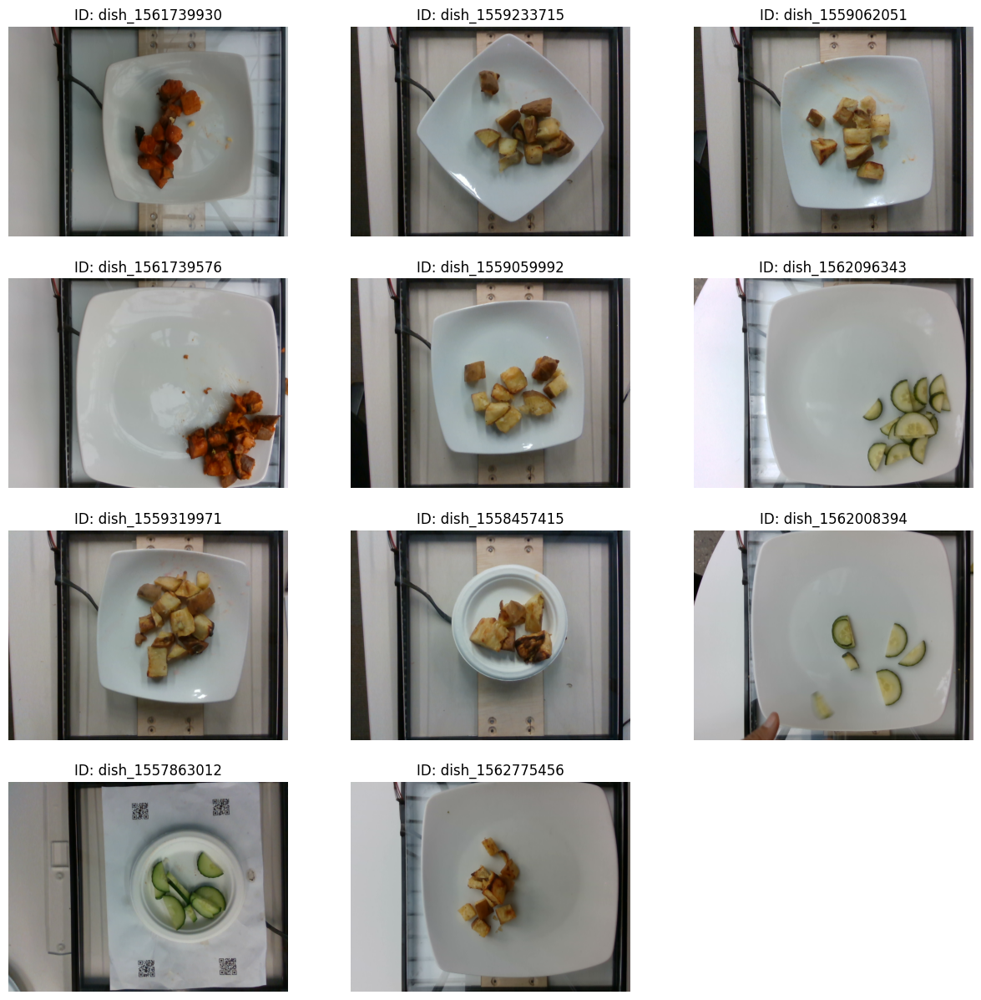

In [62]:
aux = df_dishes_fil[df_dishes_fil['total_fat']<=0]
plt.figure(figsize=(15,15))
for i, (idx, row) in enumerate(aux.iterrows()):
    img = mpimg.imread(row['rgb_path'])
    plt.subplot(4, 3, i+1)
    plt.imshow(img)
    plt.title(f"ID: {row['dish_id']}")
    plt.axis("off")
plt.show()    

In [71]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1561739930' ]

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
2661,dish_1561739930,ingr_0000000437,sweet potato,79.0,60.04,0.0,14.22,0.79,None


In [73]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1561739576']

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
8774,dish_1561739576,ingr_0000000437,sweet potato,84.0,63.84,0.0,15.12,0.84,None


In [72]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1562775456']

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
25375,dish_1562775456,ingr_0000000437,sweet potato,66.0,50.16,0.0,11.88,0.66,None


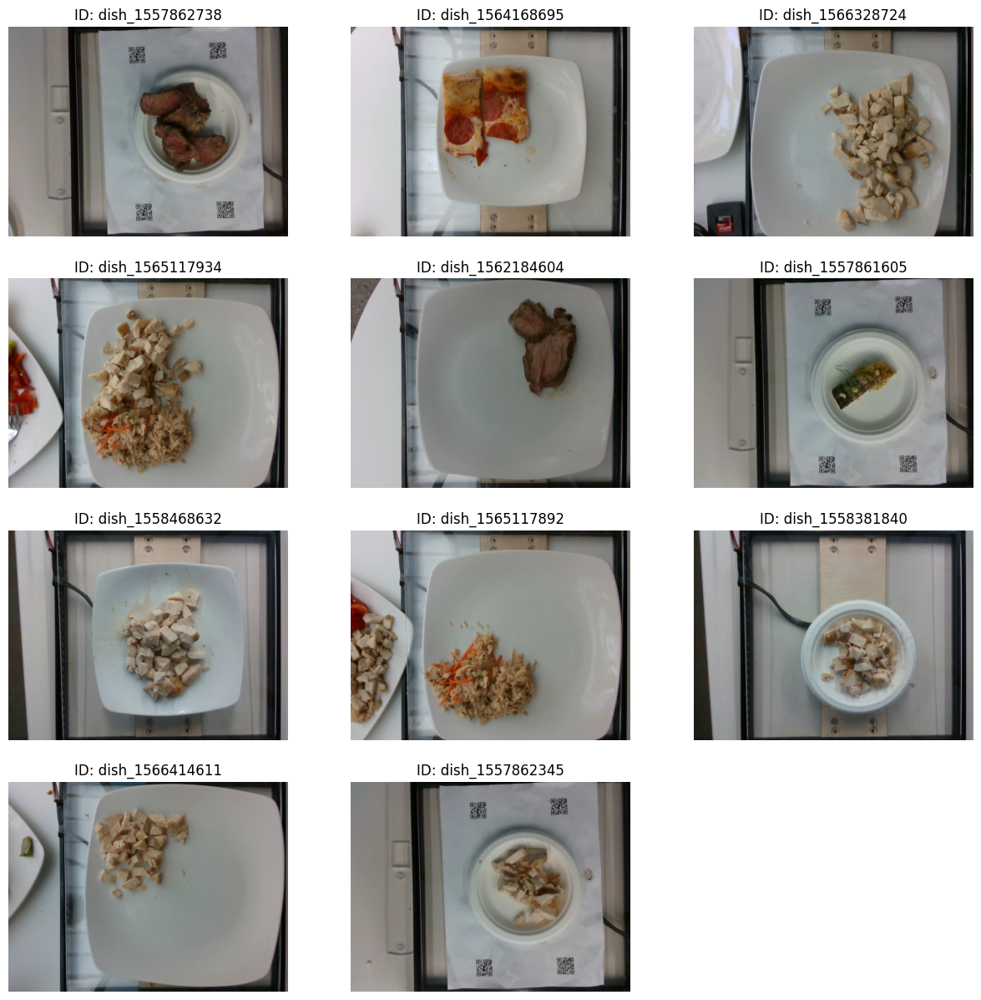

In [63]:
aux = df_dishes_fil[df_dishes_fil['total_carb']<=0]
plt.figure(figsize=(15,15))
for i, (idx, row) in enumerate(aux.iterrows()):
    img = mpimg.imread(row['rgb_path'])
    plt.subplot(4, 3, i+1)
    plt.imshow(img)
    plt.title(f"ID: {row['dish_id']}")
    plt.axis("off")
plt.show()    

In [64]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1564168695' ]

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
2812,dish_1564168695,ingr_0000000297,pepperoni,78.0,385.008,34.164,0.0,18.018,None


In [65]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1565117934' ]

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
4732,dish_1565117934,ingr_0000000244,chicken breast,133.0,219.716,4.788,0.0,41.363,None
4733,dish_1565117934,ingr_0000000402,tuna,102.0,132.600,0.612,0.0,29.580,None


In [66]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1565117892' ]

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
20277,dish_1565117892,ingr_0000000402,tuna,102.0,132.6,0.612,0.0,29.58,None


In [67]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1557861605' ]

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
17214,dish_1557861605,ingr_0000000049,fish,39.0,35.1,5.07,0.0,7.176,None


In [70]:
ingredients_df[ingredients_df['dish_id'] == 'dish_1557862345' ]

,dish_id,ingr_id,ingr_name,ingr_grams,ingr_calories,ingr_fat,ingr_carb,ingr_protein,extra
25018,dish_1557862345,ingr_0000000028,chicken,63.0,103.95,2.268,0.0,19.53,None


* Al analizar los platos podemos ver que hay una porcion de pizza que la cuenta como pepperoni solo, lo que da ese resultado de cero carbohidratos, sin embargo esto es incorrecto ya que la pizza tiene pan

In [68]:
df_dishes_fil = df_dishes_fil.drop(513)

* A partir de esta limpieza de datos usaremos estos datos para entrenar modelos

In [75]:
df_dishes_fil.to_csv('df_filtrado.csv', index = False)